<a href="https://colab.research.google.com/github/Vigneswarsiddu/Audio-Emotion-Classification-System/blob/main/Capstone_Mini_Project_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

NAME: K. VIGNESWAR SIDDU

REGNO:19MIA1013

###### IMPORTING NECESSARY LIBRARIES

In [ ]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from matplotlib.pyplot import specgram
import pandas as pd
import glob
from sklearn.metrics import confusion_matrix
import IPython.display as ipd  # To play sound in the notebook
import os
import sys
import warnings
# ignore warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore")
warnings.filterwarnings("ignore", category=DeprecationWarning)

##### DATA SET LOCATION - DIRECTORY

In [ ]:
for dirname, _, filenames in os.walk('C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

C:\Users\lenovo\OneDrive\Desktop\Audio Emotion Classification\Data\Data_path.csv
C:\Users\lenovo\OneDrive\Desktop\Audio Emotion Classification\Data\cremad\AudioWAV\1001_DFA_ANG_XX.wav
C:\Users\lenovo\OneDrive\Desktop\Audio Emotion Classification\Data\cremad\AudioWAV\1001_DFA_DIS_XX.wav
C:\Users\lenovo\OneDrive\Desktop\Audio Emotion Classification\Data\cremad\AudioWAV\1001_DFA_FEA_XX.wav
C:\Users\lenovo\OneDrive\Desktop\Audio Emotion Classification\Data\cremad\AudioWAV\1001_DFA_HAP_XX.wav
C:\Users\lenovo\OneDrive\Desktop\Audio Emotion Classification\Data\cremad\AudioWAV\1001_DFA_NEU_XX.wav
C:\Users\lenovo\OneDrive\Desktop\Audio Emotion Classification\Data\cremad\AudioWAV\1001_DFA_SAD_XX.wav
C:\Users\lenovo\OneDrive\Desktop\Audio Emotion Classification\Data\cremad\AudioWAV\1001_IEO_ANG_HI.wav
C:\Users\lenovo\OneDrive\Desktop\Audio Emotion Classification\Data\cremad\AudioWAV\1001_IEO_ANG_LO.wav
C:\Users\lenovo\OneDrive\Desktop\Audio Emotion Classification\Data\cremad\AudioWAV\1001_IEO_ANG

In [ ]:
TESS = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\tess\\TESS Toronto emotional speech set data\\TESS Toronto emotional speech set data\\"
RAV = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\ravdess\\audio_speech_actors_01-24\\"
SAVEE = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\savee\\ALL\\"
CREMA = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\cremad\\AudioWAV\\"

dir_list = os.listdir(SAVEE)
dir_list[0:5]

['DC_a01.wav', 'DC_a02.wav', 'DC_a03.wav', 'DC_a04.wav', 'DC_a05.wav']

##### Loading the Data set

In [ ]:
dir_list = os.listdir(SAVEE)

# parsing the filename to get the emotions
emotion=[]
path = []
for i in dir_list:
    if i[-8:-6]=='_a':
        emotion.append('male_angry')
    elif i[-8:-6]=='_d':
        emotion.append('male_disgust')
    elif i[-8:-6]=='_f':
        emotion.append('male_fear')
    elif i[-8:-6]=='_h':
        emotion.append('male_happy')
    elif i[-8:-6]=='_n':
        emotion.append('male_neutral')
    elif i[-8:-6]=='sa':
        emotion.append('male_sad')
    elif i[-8:-6]=='su':
        emotion.append('male_surprise')
    else:
        emotion.append('male_error')
    path.append(SAVEE + i)

# checking the label count distribution
SAVEE_df = pd.DataFrame(emotion, columns = ['labels'])
SAVEE_df['source'] = 'SAVEE'
SAVEE_df = pd.concat([SAVEE_df, pd.DataFrame(path, columns = ['path'])], axis = 1)
SAVEE_df.labels.value_counts()

male_neutral     120
male_angry        60
male_disgust      60
male_fear         60
male_happy        60
male_sad          60
male_surprise     60
Name: labels, dtype: int64

##### Exploring the data

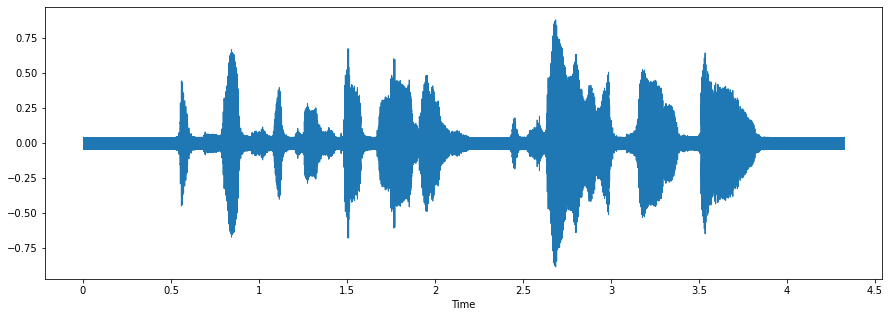

In [ ]:
fname = SAVEE + 'DC_f11.wav'
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(data, sr=sampling_rate)

# Lets play the audio
ipd.Audio(fname)

OBSERVATION: This is a fearful sample. There is No lot of background noise and the speech is very clear. So the data Quality was good and The wave plot doesn't really tell much other than there's a variation in the wave, which is good.

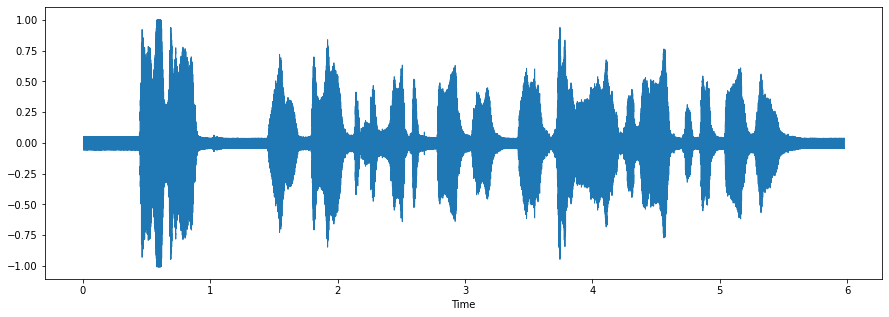

In [ ]:
# happy Auido
fname = SAVEE + 'DC_h11.wav'
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(data, sr=sampling_rate)

# play the audio
ipd.Audio(fname)

OBSERVATION: So again, good quality audio. And I can see that the wave form is distinctively different from the fear one. So that's good for the model to build.

In [ ]:
dir_list = os.listdir(RAV)
dir_list.sort()

emotion = []
gender = []
path = []
for i in dir_list:
    fname = os.listdir(RAV + i)
    for f in fname:
        part = f.split('.')[0].split('-')
        emotion.append(int(part[2]))
        temp = int(part[6])
        if temp%2 == 0:
            temp = "female"
        else:
            temp = "male"
        gender.append(temp)
        path.append(RAV + i + '/' + f)


RAV_df = pd.DataFrame(emotion)
RAV_df = RAV_df.replace({1:'neutral', 2:'neutral', 3:'happy', 4:'sad', 5:'angry', 6:'fear', 7:'disgust', 8:'surprise'})
RAV_df = pd.concat([pd.DataFrame(gender),RAV_df],axis=1)
RAV_df.columns = ['gender','emotion']
RAV_df['labels'] =RAV_df.gender + '_' + RAV_df.emotion
RAV_df['source'] = 'RAVDESS'
RAV_df = pd.concat([RAV_df,pd.DataFrame(path, columns = ['path'])],axis=1)
RAV_df = RAV_df.drop(['gender', 'emotion'], axis=1)
RAV_df.labels.value_counts()

male_neutral       144
female_neutral     144
male_happy          96
male_sad            96
male_angry          96
male_fear           96
male_disgust        96
male_surprise       96
female_happy        96
female_sad          96
female_angry        96
female_fear         96
female_disgust      96
female_surprise     96
Name: labels, dtype: int64

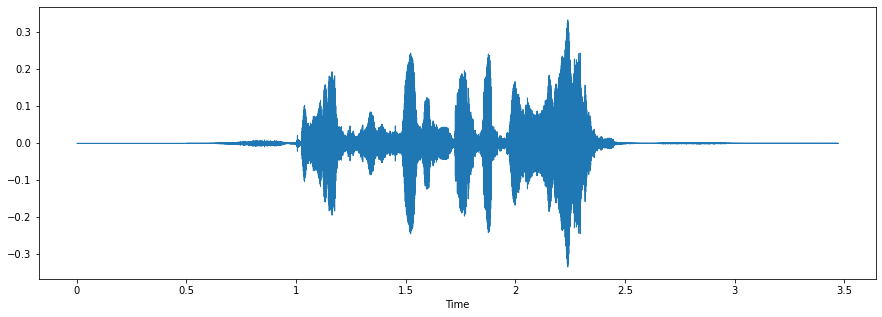

In [ ]:
# Fear Audio
fname = RAV + 'Actor_14/03-01-06-02-02-02-14.wav'
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(data, sr=sampling_rate)

# Lets play the audio
ipd.Audio(fname)

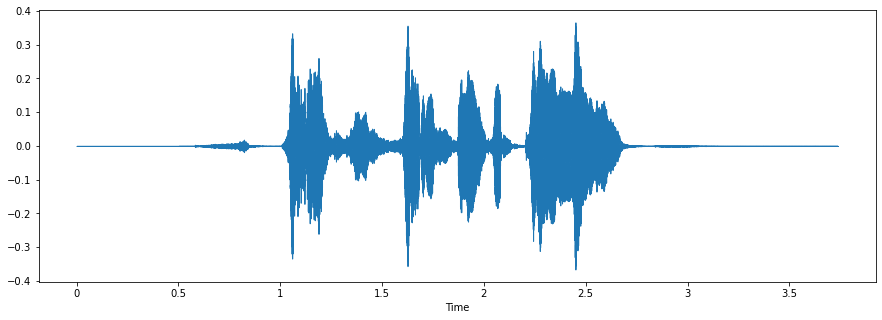

In [ ]:
# happy Audio
fname = RAV + 'Actor_14/03-01-03-02-02-02-14.wav'
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(data, sr=sampling_rate)

# Lets play the audio
ipd.Audio(fname)

In [ ]:
dir_list = os.listdir(TESS)
dir_list.sort()
dir_list

['OAF_Fear',
 'OAF_Pleasant_surprise',
 'OAF_Sad',
 'OAF_angry',
 'OAF_disgust',
 'OAF_happy',
 'OAF_neutral',
 'YAF_angry',
 'YAF_disgust',
 'YAF_fear',
 'YAF_happy',
 'YAF_neutral',
 'YAF_pleasant_surprised',
 'YAF_sad']

In [ ]:
path = []
emotion = []

for i in dir_list:
    fname = os.listdir(TESS + i)
    for f in fname:
        if i == 'OAF_angry' or i == 'YAF_angry':
            emotion.append('female_angry')
        elif i == 'OAF_disgust' or i == 'YAF_disgust':
            emotion.append('female_disgust')
        elif i == 'OAF_Fear' or i == 'YAF_fear':
            emotion.append('female_fear')
        elif i == 'OAF_happy' or i == 'YAF_happy':
            emotion.append('female_happy')
        elif i == 'OAF_neutral' or i == 'YAF_neutral':
            emotion.append('female_neutral')
        elif i == 'OAF_Pleasant_surprise' or i == 'YAF_pleasant_surprised':
            emotion.append('female_surprise')
        elif i == 'OAF_Sad' or i == 'YAF_sad':
            emotion.append('female_sad')
        else:
            emotion.append('Unknown')
        path.append(TESS + i + "/" + f)

TESS_df = pd.DataFrame(emotion, columns = ['labels'])
TESS_df['source'] = 'TESS'
TESS_df = pd.concat([TESS_df,pd.DataFrame(path, columns = ['path'])],axis=1)
TESS_df.labels.value_counts()

female_fear        400
female_surprise    400
female_sad         400
female_angry       400
female_disgust     400
female_happy       400
female_neutral     400
Name: labels, dtype: int64

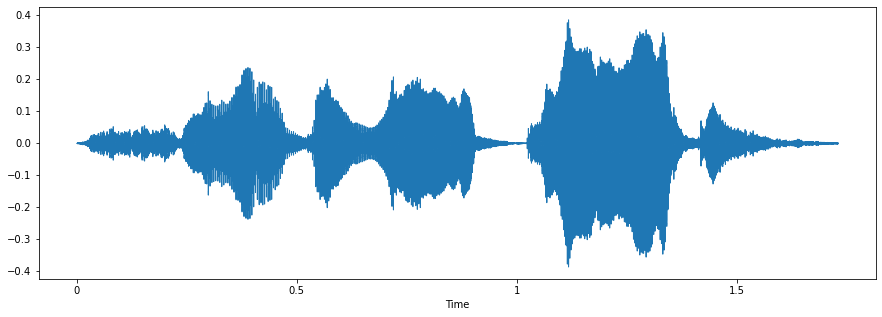

In [ ]:
# Fear Audio
fname = TESS + 'YAF_fear/YAF_dog_fear.wav'

data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(data, sr=sampling_rate)

# Lets play the audio
ipd.Audio(fname)

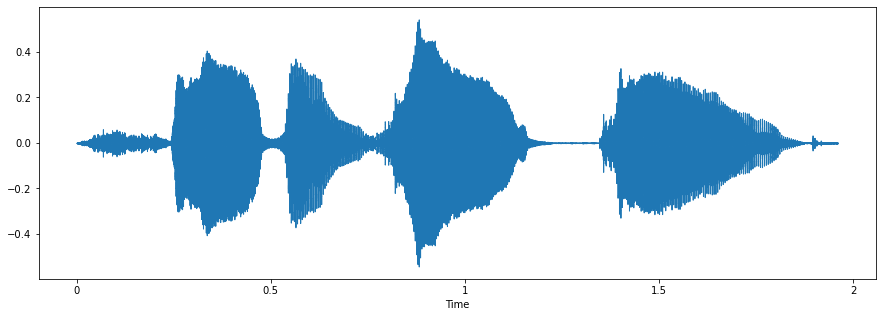

In [ ]:
#Happy Audio
fname =  TESS + 'YAF_happy/YAF_dog_happy.wav'

data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(data, sr=sampling_rate)

# Lets play the audio
ipd.Audio(fname)

In [ ]:
dir_list = os.listdir(CREMA)
dir_list.sort()
print(dir_list[0:10])

['1001_DFA_ANG_XX.wav', '1001_DFA_DIS_XX.wav', '1001_DFA_FEA_XX.wav', '1001_DFA_HAP_XX.wav', '1001_DFA_NEU_XX.wav', '1001_DFA_SAD_XX.wav', '1001_IEO_ANG_HI.wav', '1001_IEO_ANG_LO.wav', '1001_IEO_ANG_MD.wav', '1001_IEO_DIS_HI.wav']


In [ ]:
gender = []
emotion = []
path = []
female = [1002,1003,1004,1006,1007,1008,1009,1010,1012,1013,1018,1020,1021,1024,1025,1028,1029,1030,1037,1043,1046,1047,1049,
          1052,1053,1054,1055,1056,1058,1060,1061,1063,1072,1073,1074,1075,1076,1078,1079,1082,1084,1089,1091]

for i in dir_list:
    part = i.split('_')
    if int(part[0]) in female:
        temp = 'female'
    else:
        temp = 'male'
    gender.append(temp)
    if part[2] == 'SAD' and temp == 'male':
        emotion.append('male_sad')
    elif part[2] == 'ANG' and temp == 'male':
        emotion.append('male_angry')
    elif part[2] == 'DIS' and temp == 'male':
        emotion.append('male_disgust')
    elif part[2] == 'FEA' and temp == 'male':
        emotion.append('male_fear')
    elif part[2] == 'HAP' and temp == 'male':
        emotion.append('male_happy')
    elif part[2] == 'NEU' and temp == 'male':
        emotion.append('male_neutral')
    elif part[2] == 'SAD' and temp == 'female':
        emotion.append('female_sad')
    elif part[2] == 'ANG' and temp == 'female':
        emotion.append('female_angry')
    elif part[2] == 'DIS' and temp == 'female':
        emotion.append('female_disgust')
    elif part[2] == 'FEA' and temp == 'female':
        emotion.append('female_fear')
    elif part[2] == 'HAP' and temp == 'female':
        emotion.append('female_happy')
    elif part[2] == 'NEU' and temp == 'female':
        emotion.append('female_neutral')
    else:
        emotion.append('Unknown')
    path.append(CREMA + i)

CREMA_df = pd.DataFrame(emotion, columns = ['labels'])
CREMA_df['source'] = 'CREMA'
CREMA_df = pd.concat([CREMA_df,pd.DataFrame(path, columns = ['path'])],axis=1)
CREMA_df.labels.value_counts()

male_angry        671
male_disgust      671
male_fear         671
male_happy        671
male_sad          671
female_angry      600
female_disgust    600
female_fear       600
female_happy      600
female_sad        600
male_neutral      575
female_neutral    512
Name: labels, dtype: int64

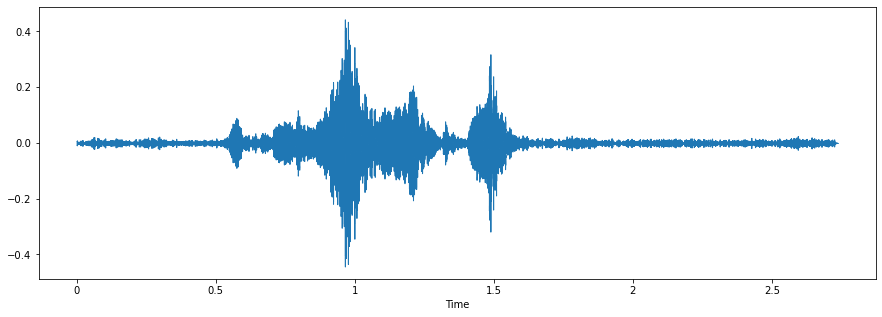

In [ ]:
# Happy Audio
fname = CREMA + '1012_IEO_HAP_HI.wav'
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(data, sr=sampling_rate)
#play
ipd.Audio(fname)

OBSERVATION: the above audio Its not as clear as what I saw from the other data sets. And I'm not so sure if it'd consider the emotion happy. Sounds to me more like neutral. But it could be due to the audio quality. So, I will take a fearful one for better understanding.

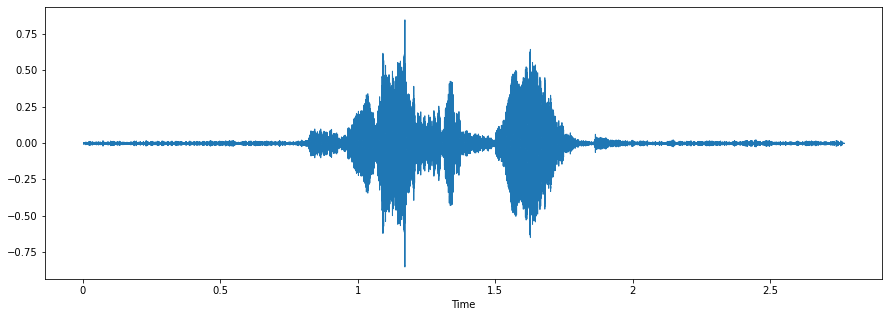

In [ ]:
# Fear Audio
fname = CREMA + '1012_IEO_FEA_HI.wav'
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(data, sr=sampling_rate)

# play
ipd.Audio(fname)

OBSERVATION: It sounds fearful emotion. which is much clearer than the happy version. I went back to dataset and listened some random tracks and what I noticed with this CREMA-D dataset is that its is highly varied in its quality. Some are not clear. Also there's lots of silence as well.

In [ ]:
df = pd.concat([SAVEE_df, RAV_df, TESS_df, CREMA_df], axis = 0)
print(df.labels.value_counts())
df.head()
df.to_csv("Data_path.csv",index=False)

female_happy       1096
female_sad         1096
female_angry       1096
female_fear        1096
female_disgust     1096
female_neutral     1056
male_neutral        839
male_angry          827
male_disgust        827
male_fear           827
male_happy          827
male_sad            827
female_surprise     496
male_surprise       156
Name: labels, dtype: int64


MY POINT OF VIEW:  I feel I can combine all the data. otherwise I will ger with overfitting Problem. One of the issues that I see many reserach papers that who have made an attempt on an emotion classifier, they tend to stick to just one dataset. And their accuracy is high, but they don't work well on new unseen dataset.

and this is because, the classifier is trained on the same dataset and given that the dataset was obtained with perfect audio quality, speaker repetition, duration.

## Feature Extraction

In [ ]:
#!pip install resampy

In [ ]:
import resampy

In [ ]:
# Data - RAVDESS; Gender - Female; Emotion - Angry
path ="C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\ravdess\\audio_speech_actors_01-24\\Actor_08\\03-01-05-02-01-01-08.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)
mfcc = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)

Text(0.5, 1.0, 'Audio sampled at 44100 hrz')

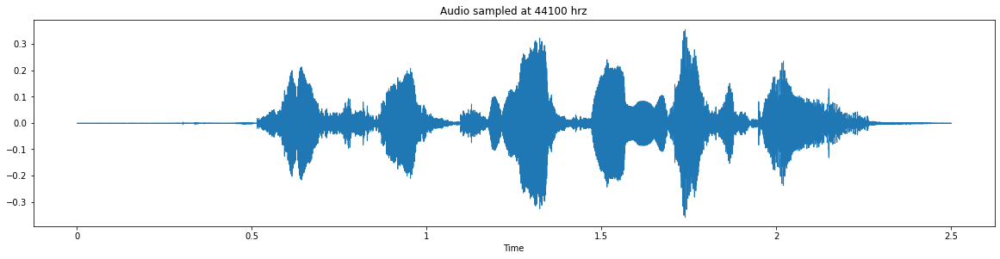

In [ ]:
# audio wave
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.waveshow(X, sr=sample_rate)
plt.title('Audio sampled at 44100 hrz')

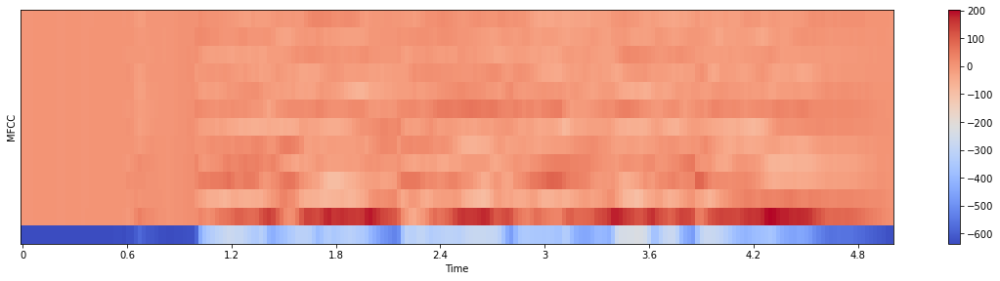

In [ ]:
# MFCC
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.specshow(mfcc, x_axis='time')
plt.ylabel('MFCC')
plt.colorbar()

ipd.Audio(path)

In [ ]:
# Data - RAVDESS; Gender - Male; Emotion - Angry
path = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\ravdess\\audio_speech_actors_01-24\\Actor_09\\03-01-05-01-01-01-09.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)
mfcc = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)

Text(0.5, 1.0, 'Audio sampled at 44100 hrz')

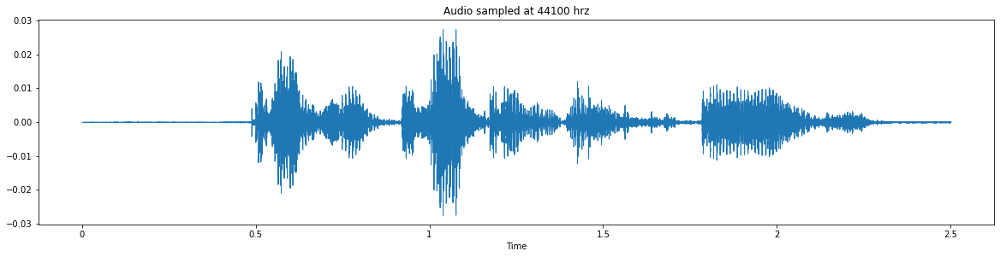

In [ ]:
# audio wave
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.waveshow(X, sr=sample_rate)
plt.title('Audio sampled at 44100 hrz')


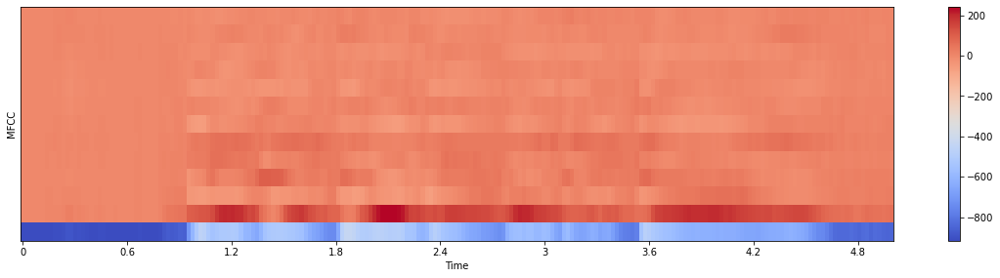

In [ ]:
# MFCC
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.specshow(mfcc, x_axis='time')
plt.ylabel('MFCC')
plt.colorbar()
ipd.Audio(path)

In [ ]:
# Source - RAVDESS; Gender - Female; Emotion - Happy
path = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\ravdess\\audio_speech_actors_01-24\\Actor_12\\03-01-03-01-02-01-12.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)
mfcc = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)


Text(0.5, 1.0, 'Audio sampled at 44100 hrz')

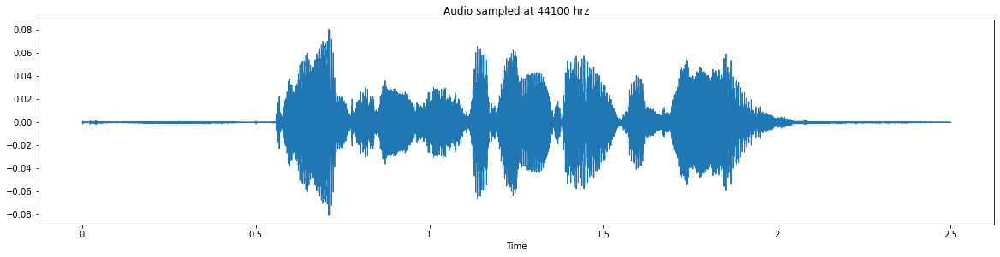

In [ ]:
# audio wave
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.waveshow(X, sr=sample_rate)
plt.title('Audio sampled at 44100 hrz')

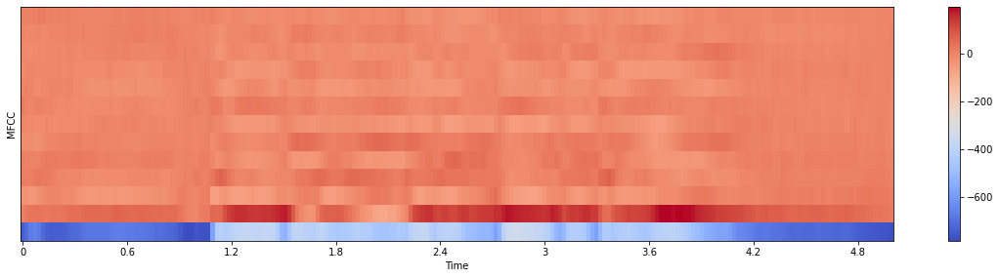

In [ ]:
# MFCC
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.specshow(mfcc, x_axis='time')
plt.ylabel('MFCC')
plt.colorbar()

ipd.Audio(path)

In [ ]:
# Source - RAVDESS; Gender - Male; Emotion - Happy
path = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\ravdess\\audio_speech_actors_01-24\\Actor_11\\03-01-03-01-02-02-11.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)
mfcc = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)

Text(0.5, 1.0, 'Audio sampled at 44100 hrz')

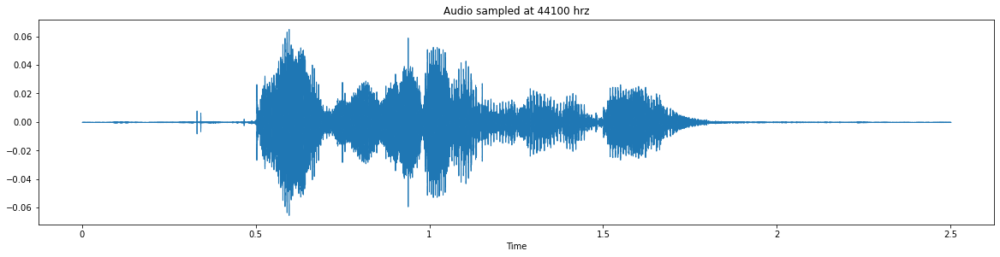

In [ ]:
# audio wave
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.waveshow(X, sr=sample_rate)
plt.title('Audio sampled at 44100 hrz')

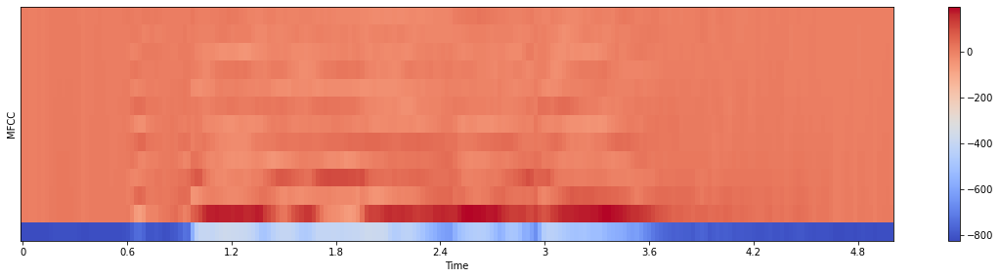

In [ ]:
# MFCC
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
librosa.display.specshow(mfcc, x_axis='time')
plt.ylabel('MFCC')
plt.colorbar()
ipd.Audio(path)

## Statistics Feature

In [ ]:
# Source - RAVDESS; Gender - Female; Emotion - Angry
path = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\ravdess\\audio_speech_actors_01-24\\Actor_08\\03-01-05-02-01-01-08.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)
female = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)
female = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13), axis=0)
print(len(female))


216


In [ ]:
# Source - RAVDESS; Gender - Male; Emotion - Angry
path = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\ravdess\\audio_speech_actors_01-24\\Actor_09\\03-01-05-01-01-01-09.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)
male = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)
male = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13), axis=0)
print(len(male))

216


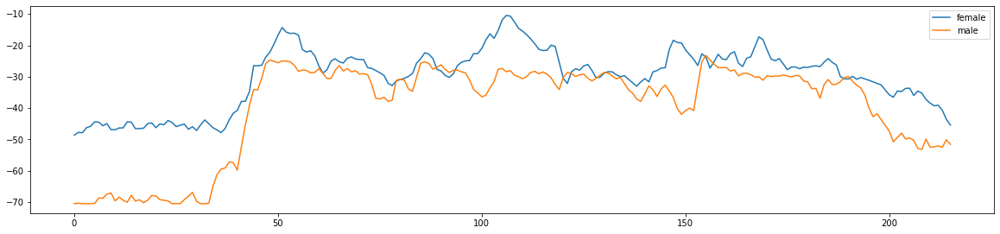

In [ ]:
# audio wave
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
plt.plot(female, label='female')
plt.plot(male, label='male')
plt.legend()

In [ ]:
# Source - RAVDESS; Gender - Female; Emotion - happy
path = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\ravdess\\audio_speech_actors_01-24\\Actor_12\\03-01-03-01-02-01-12.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)
female = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)
female = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13), axis=0)
print(len(female))

216


In [ ]:
# Source - RAVDESS; Gender - Male; Emotion - happy
path = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\ravdess\\audio_speech_actors_01-24\\Actor_11\\03-01-03-01-02-02-11.wav"
X, sample_rate = librosa.load(path, res_type='kaiser_fast',duration=2.5,sr=22050*2,offset=0.5)
male = librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13)
male = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13), axis=0)
print(len(male))

216


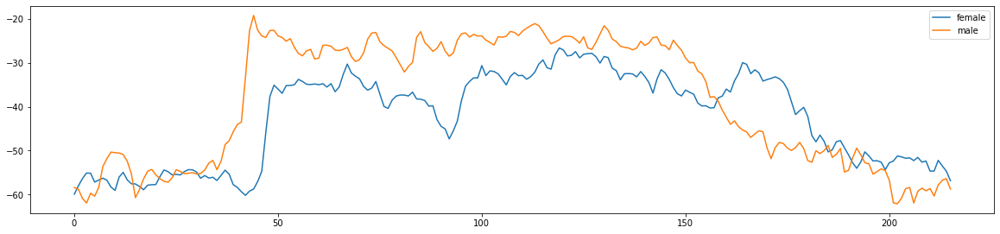

In [ ]:
# Plotting the two audio waves together
plt.figure(figsize=(20, 15))
plt.subplot(3,1,1)
plt.plot(female, label='female')
plt.plot(male, label='male')
plt.legend()

Using MFCC is a good feature to differentiate the gender and emotions.it seems I captured captured enough to be able to see some difference.

## BASELINE MODEL

In [ ]:
# Importing neccessary libraries
# Keras
import keras
from keras import regularizers
from keras.preprocessing import sequence
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential, Model, model_from_json
from keras.layers import Dense, Embedding, LSTM
from keras.layers import Input, Flatten, Dropout, Activation, BatchNormalization
from keras.layers import Conv1D, MaxPooling1D, AveragePooling1D
from keras.utils import np_utils
from tensorflow.keras.utils import to_categorical
from keras.callbacks import ModelCheckpoint

# sklearn
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# Other  libraries
import librosa
import librosa.display
import json
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from matplotlib.pyplot import specgram
import pandas as pd
import seaborn as sns
import glob
import os
import pickle
import IPython.display as ipd

In [ ]:
# picking up the data that I got earlier
ref = pd.read_csv("C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\Data_path.csv")
ref.head()

,labels,source,path
0,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...
1,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...
2,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...
3,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...
4,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...


In [ ]:
# large Time taking ---------------------
df = pd.DataFrame(columns=['feature'])

# loop feature extraction over the entire dataset
counter=0
for index,path in enumerate(ref.path):
    X, sample_rate = librosa.load(path
                                  , res_type='kaiser_fast'
                                  ,duration=2.5
                                  ,sr=44100
                                  ,offset=0.5
                                 )
    sample_rate = np.array(sample_rate)

    # mean as the feature. Could do min and max.
    mfccs = np.mean(librosa.feature.mfcc(y=X,
                                        sr=sample_rate,
                                        n_mfcc=13),
                    axis=0)
    df.loc[counter] = [mfccs]
    counter=counter+1
    print(counter, mfccs)

# Checking a few records to make sure its processed successfully
print(len(df))
df.head()

1 [ -4.641421   -3.860898   -6.21919    -5.9265423  -5.850419   -4.80896
  -2.5130029  -3.5005367  -3.721045   -4.4875593  -5.4290113  -7.3055735
  -7.14193    -6.5555754  -4.5162992  -2.5563965  -2.251577   -5.13335
  -5.566185   -7.20538    -7.9091716 -10.862606  -13.266886  -13.715888
 -15.576246   -8.864893   -5.8697057  -3.96915    -4.066767   -6.243663
  -5.8144526  -7.329671   -8.715132   -8.864924  -10.491897  -11.772941
 -12.314169  -13.577661  -14.217988  -11.312407   -9.449202   -9.782572
 -11.307087  -15.080504  -18.698631  -21.29243   -20.248941  -20.51274
 -20.142696  -19.977814  -19.676876  -21.12687   -21.941769  -22.895468
 -23.481457  -22.928883  -23.43159   -23.819021  -15.2186365  -7.6818385
  -4.474264   -3.4271357  -2.740891   -2.44721    -3.4177985  -3.427022
  -3.8396382  -5.1096735  -6.4226065  -7.8297963  -7.852357  -10.302065
 -11.0794115 -15.0834675 -16.734554  -20.405901  -23.169233  -20.038586
 -16.494411  -14.6714115 -14.88214   -13.396998   -9.339136   -

,feature
0,"[-4.641421, -3.860898, -6.21919, -5.9265423, -..."
1,"[-8.690716, -12.522837, -22.928043, -23.243807..."
2,"[-8.814859, -12.819055, -24.178183, -23.84745,..."
3,"[-2.2684252, -4.317077, -12.285237, -13.083024..."
4,"[-13.485307, -16.26042, -25.884357, -27.827044..."


In [ ]:
# I am Saving it
df.to_pickle('my4EmotionDatabases-mfccs')

In [ ]:
# Loading the saved feature data
df = pd.read_pickle('my4EmotionDatabases-mfccs')
df.head()

,feature
0,"[-4.641421, -3.860898, -6.21919, -5.9265423, -..."
1,"[-8.690716, -12.522837, -22.928043, -23.243807..."
2,"[-8.814859, -12.819055, -24.178183, -23.84745,..."
3,"[-2.2684252, -4.317077, -12.285237, -13.083024..."
4,"[-13.485307, -16.26042, -25.884357, -27.827044..."


In [ ]:
# Now I am extracting the mean bands to its own feature columns
df = pd.concat([ref,pd.DataFrame(df['feature'].values.tolist())],axis=1)
df[:5]

,labels,source,path,0,1,2,3,4,5,6,...,206,207,208,209,210,211,212,213,214,215
0,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-4.641421,-3.860898,-6.219190,-5.926542,-5.850419,-4.808960,-2.513003,...,-4.088852,-5.023864,-5.254714,-5.234095,-5.310307,-5.621665,-6.072197,-6.611348,-3.999875,1.390506
1,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-8.690716,-12.522837,-22.928043,-23.243807,-22.926605,-23.432241,-14.830004,...,-22.627258,-22.633406,-22.511597,-24.300154,-24.496809,-22.895985,-23.511503,-24.342152,-16.465857,-8.936035
2,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-8.814859,-12.819055,-24.178183,-23.847450,-15.182783,-10.732485,-8.681472,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-2.268425,-4.317077,-12.285237,-13.083024,-12.041327,-11.819768,-9.414148,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-13.485307,-16.260420,-25.884357,-27.827044,-27.593534,-26.666508,-18.659023,...,-25.291666,-25.854906,-26.821354,-25.436455,-24.179941,-23.281618,-24.167494,-25.228062,-20.599659,-15.929615


In [ ]:
# replacing NA with 0
df=df.fillna(0)
print(df.shape)
df[:5]

(12162, 219)


,labels,source,path,0,1,2,3,4,5,6,...,206,207,208,209,210,211,212,213,214,215
0,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-4.641421,-3.860898,-6.219190,-5.926542,-5.850419,-4.808960,-2.513003,...,-4.088852,-5.023864,-5.254714,-5.234095,-5.310307,-5.621665,-6.072197,-6.611348,-3.999875,1.390506
1,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-8.690716,-12.522837,-22.928043,-23.243807,-22.926605,-23.432241,-14.830004,...,-22.627258,-22.633406,-22.511597,-24.300154,-24.496809,-22.895985,-23.511503,-24.342152,-16.465857,-8.936035
2,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-8.814859,-12.819055,-24.178183,-23.847450,-15.182783,-10.732485,-8.681472,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-2.268425,-4.317077,-12.285237,-13.083024,-12.041327,-11.819768,-9.414148,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-13.485307,-16.260420,-25.884357,-27.827044,-27.593534,-26.666508,-18.659023,...,-25.291666,-25.854906,-26.821354,-25.436455,-24.179941,-23.281618,-24.167494,-25.228062,-20.599659,-15.929615


In [ ]:
# Splitting training and testing
X_train, X_test, y_train, y_test = train_test_split(df.drop(['path','labels','source'],axis=1), df.labels, test_size=0.25
                                                    , shuffle=True
                                                    , random_state=42
                                                   )
X_train[150:160]

,0,1,2,3,4,5,6,7,8,9,...,206,207,208,209,210,211,212,213,214,215
4950,-17.142696,-17.249537,-18.365582,-18.948351,-17.365459,-16.711090,-17.699482,-18.021383,-17.897398,-15.878503,...,-22.865425,-21.614164,-19.724932,-18.845335,-19.363422,-20.137630,-22.65514,-24.578310,-24.039165,-23.209587
3860,-13.285582,-16.784794,-23.058235,-22.435648,-20.332132,-19.029638,-19.715996,-13.186264,-11.762837,-16.709417,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
9761,-4.823565,-6.056048,-9.580621,-12.012063,-9.959867,-11.912548,-13.994515,-13.555813,-14.022305,-15.118246,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
7620,-7.031146,-4.253551,-4.534490,-5.836689,-5.248197,-6.456452,-8.122451,-9.154640,-8.647813,-8.178625,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
11586,-22.565975,-21.767015,-20.529488,-20.669310,-21.171085,-18.573399,-18.412350,-16.178038,-14.222460,-15.122540,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
7914,-20.082027,-18.982424,-17.009443,-16.944057,-19.334974,-19.527683,-21.974346,-20.144060,-17.954927,-19.302570,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
9513,-20.103537,-18.625866,-16.116108,-16.929592,-18.197664,-18.149664,-19.240425,-18.361637,-16.917982,-16.639193,...,-17.848896,-19.357054,-17.748692,-19.136808,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
5835,-21.078182,-18.671947,-17.676802,-18.009502,-18.218781,-18.676929,-16.592762,-17.796528,-17.992470,-17.824917,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
5389,-22.707445,-20.160748,-18.926155,-19.429979,-19.278114,-18.125767,-18.068565,-19.879320,-20.896755,-19.176098,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
11222,-20.008287,-17.640305,-19.188612,-18.435749,-17.538836,-17.817177,-17.898476,-20.555359,-18.578117,-15.957151,...,-18.031603,-18.101122,-19.630695,-20.707493,-20.239124,-18.337662,-15.54331,-17.478794,-17.017057,-19.112486


As I am mixing up a few different data, it would be good to normalise the data.to improve the accuracy and speed up the training process.

In [ ]:
# data normalization
mean = np.mean(X_train, axis=0)
std = np.std(X_train, axis=0)

X_train = (X_train - mean)/std
X_test = (X_test - mean)/std

# Checking the dataset
X_train[150:160]

,0,1,2,3,4,5,6,7,8,9,...,206,207,208,209,210,211,212,213,214,215
4950,0.372041,0.350813,0.438077,0.388329,0.499365,0.543762,0.462607,0.433153,0.435840,0.580892,...,-0.881535,-0.813732,-0.693296,-0.631321,-0.678039,-0.721057,-0.863782,-0.987440,-0.973409,-0.919264
3860,0.649922,0.385111,0.089813,0.130056,0.279970,0.372252,0.313699,0.789556,0.887543,0.519730,...,0.540014,0.526057,0.525595,0.526507,0.511674,0.511928,0.512796,0.501254,0.494771,0.488186
9761,1.259558,1.176895,1.090050,0.902038,1.047032,0.898727,0.736199,0.762316,0.721172,0.636852,...,0.540014,0.526057,0.525595,0.526507,0.511674,0.511928,0.512796,0.501254,0.494771,0.488186
7620,1.100516,1.309920,1.464547,1.359393,1.395475,1.302332,1.169819,1.086732,1.116909,1.147656,...,0.540014,0.526057,0.525595,0.526507,0.511674,0.511928,0.512796,0.501254,0.494771,0.488186
11586,-0.018673,0.017422,0.277484,0.260873,0.217926,0.406001,0.409966,0.569028,0.706435,0.636536,...,0.540014,0.526057,0.525595,0.526507,0.511674,0.511928,0.512796,0.501254,0.494771,0.488186
7914,0.160280,0.222926,0.538723,0.536769,0.353713,0.335409,0.146932,0.276688,0.431604,0.328856,...,0.540014,0.526057,0.525595,0.526507,0.511674,0.511928,0.512796,0.501254,0.494771,0.488186
9513,0.158730,0.249240,0.605021,0.537840,0.437820,0.437346,0.348817,0.408072,0.507957,0.524899,...,-0.569656,-0.673821,-0.571176,-0.649229,0.511674,0.511928,0.512796,0.501254,0.494771,0.488186
5835,0.088513,0.245839,0.489195,0.457861,0.436259,0.398343,0.544332,0.449727,0.428840,0.437622,...,0.540014,0.526057,0.525595,0.526507,0.511674,0.511928,0.512796,0.501254,0.494771,0.488186
5389,-0.028865,0.135965,0.396474,0.352659,0.357918,0.439114,0.435352,0.296202,0.214990,0.338166,...,0.540014,0.526057,0.525595,0.526507,0.511674,0.511928,0.512796,0.501254,0.494771,0.488186
11222,0.165592,0.321974,0.376996,0.426293,0.486543,0.461941,0.447913,0.246370,0.385717,0.575102,...,-0.581015,-0.595970,-0.687473,-0.745729,-0.731844,-0.610848,-0.431651,-0.557426,-0.544537,-0.670812


Here I need to convert the data format to a numpy array, because I am using keras

In [ ]:
# Tranform Keras
X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)

In [ ]:
# one hot encoding for the target Prediction
lb = LabelEncoder()
y_train = np_utils.to_categorical(lb.fit_transform(y_train))
y_test = np_utils.to_categorical(lb.fit_transform(y_test))

In [ ]:
print(X_train.shape)
print(lb.classes_)
print(y_train[0:10])
print(y_test[0:10])

(9121, 216)
['female_angry' 'female_disgust' 'female_fear' 'female_happy'
 'female_neutral' 'female_sad' 'female_surprise' 'male_angry'
 'male_disgust' 'male_fear' 'male_happy' 'male_neutral' 'male_sad'
 'male_surprise']
[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]]
[[0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0.

In [ ]:
# Saving it future use
filename = 'labels'
outfile = open(filename,'wb')
pickle.dump(lb,outfile)
outfile.close()

Now because I am going to use a CNN, to specify the 3rd dimension, which is 1. Its 1 because I am doing a 1D CNN

In [ ]:
X_train = np.expand_dims(X_train, axis=2)
X_test = np.expand_dims(X_test, axis=2)
X_train.shape

(9121, 216, 1)

In [ ]:
from tensorflow import keras
from keras import optimizers

## Model

In [ ]:
# New model
model = Sequential()
model.add(Conv1D(256, 8, padding='same',input_shape=(X_train.shape[1],1)))  # X_train.shape[1] = No. of Columns
model.add(Activation('relu'))
model.add(Conv1D(256, 8, padding='same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))
model.add(MaxPooling1D(pool_size=(8)))
model.add(Conv1D(128, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(128, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(128, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(128, 8, padding='same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))
model.add(MaxPooling1D(pool_size=(8)))
model.add(Conv1D(64, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(64, 8, padding='same'))
model.add(Activation('relu'))
model.add(Flatten())
model.add(Dense(14)) # Target class number
model.add(Activation('softmax'))
opt = keras.optimizers.RMSprop(lr=0.00001, decay=1e-6)
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 216, 256)          2304      
                                                                 
 activation (Activation)     (None, 216, 256)          0         
                                                                 
 conv1d_1 (Conv1D)           (None, 216, 256)          524544    
                                                                 
 batch_normalization (BatchN  (None, 216, 256)         1024      
 ormalization)                                                   
                                                                 
 activation_1 (Activation)   (None, 216, 256)          0         
                                                                 
 dropout (Dropout)           (None, 216, 256)          0         
                                                        

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer=opt,metrics=['accuracy'])
model_history=model.fit(X_train, y_train, batch_size=16, epochs=100, validation_data=(X_test, y_test))

Epoch 1/100
571/571 [==============================] - 118s 204ms/step - loss: 2.4306 - accuracy: 0.1930 - val_loss: 2.4563 - val_accuracy: 0.2374
Epoch 2/100
571/571 [==============================] - 116s 203ms/step - loss: 2.1856 - accuracy: 0.2672 - val_loss: 2.2264 - val_accuracy: 0.2933
Epoch 3/100
571/571 [==============================] - 115s 201ms/step - loss: 2.0648 - accuracy: 0.2977 - val_loss: 2.1469 - val_accuracy: 0.3009
Epoch 4/100
571/571 [==============================] - 115s 202ms/step - loss: 1.9866 - accuracy: 0.3288 - val_loss: 2.0848 - val_accuracy: 0.3256
Epoch 5/100
571/571 [==============================] - 116s 203ms/step - loss: 1.9343 - accuracy: 0.3432 - val_loss: 2.0245 - val_accuracy: 0.3581
Epoch 6/100
571/571 [==============================] - 115s 201ms/step - loss: 1.8853 - accuracy: 0.3572 - val_loss: 1.9787 - val_accuracy: 0.3663
Epoch 7/100
571/571 [==============================] - 116s 203ms/step - loss: 1.8350 - accuracy: 0.3791 - val_loss: 1

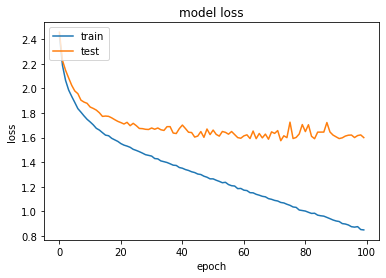

In [ ]:
plt.plot(model_history.history['loss'])
plt.plot(model_history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

I can see that the loss starts to plateau now at around 50 epochs

## Model Serialization

Iam going to serialise the model for re-usability.

In [ ]:
# Saving model and weights
model_name = 'Emotion_Model.h5'
save_dir = os.path.join(os.getcwd(), 'saved_models')

if not os.path.isdir(save_dir):
    os.makedirs(save_dir)
model_path = os.path.join(save_dir, model_name)
model.save(model_path)
print('Save model and weights at %s ' % model_path)

# Saving the model to my disk
model_json = model.to_json()
with open("model_json.json", "w") as json_file:
    json_file.write(model_json)

Save model and weights at C:\Users\lenovo\saved_models\Emotion_Model.h5 


## Model Validation

Now I am predicting emotions on the test data. After serialising the model, i'm going to just reload it into disk. Essentially to re-use the model without having to re-running the code,I just need to apply the model to a new dataset. the result is essentially the same as the last epoch of 100 which is 44.62%

In [ ]:
# loading json and model architecture
json_file = open('model_json.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)

# loading weights into new model
loaded_model.load_weights("saved_models/Emotion_Model.h5")
print("Loaded model from disk")

Loaded model from disk


In [ ]:
# Keras optimiser
opt = keras.optimizers.RMSprop(lr=0.00001, decay=1e-6)
loaded_model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
score = loaded_model.evaluate(X_test, y_test, verbose=0)
print("%s: %.2f%%" % (loaded_model.metrics_names[1], score[1]*100))

accuracy: 43.93%


In [ ]:
preds = loaded_model.predict(X_test,
                         batch_size=16,
                         verbose=1)

preds=preds.argmax(axis=1)
preds

191/191 [==============================] - 9s 43ms/step


array([ 4,  3,  7, ...,  2,  4, 10], dtype=int64)

Now the prediction is in the form of numbers, so I need to append the labels to it before I am going to run the accuracy measure.

In [ ]:
# predictions
preds = preds.astype(int).flatten()
preds = (lb.inverse_transform((preds)))
preds = pd.DataFrame({'predictedvalues': preds})

# Actual labels
actual=y_test.argmax(axis=1)
actual = actual.astype(int).flatten()
actual = (lb.inverse_transform((actual)))
actual = pd.DataFrame({'actualvalues': actual})

In [ ]:
# combined both of them into a single dataframe
finaldf = actual.join(preds)
finaldf[170:180]

,actualvalues,predictedvalues
170,male_sad,male_sad
171,female_neutral,female_neutral
172,male_angry,male_angry
173,female_disgust,female_disgust
174,male_angry,male_angry
175,female_fear,male_happy
176,male_neutral,male_neutral
177,female_fear,female_happy
178,female_happy,female_neutral
179,female_neutral,female_neutral


In [ ]:
# Saving the predictions to disk
finaldf.to_csv('Predictions.csv', index=False)
finaldf.groupby('predictedvalues').count()

,actualvalues
predictedvalues,
female_angry,257
female_disgust,324
female_fear,250
female_happy,209
female_neutral,402
female_sad,246
female_surprise,117
male_angry,238
male_disgust,102


The most common way to visualise the above output is through confusion matrix. Iam going to make the heat map plot to visualise the accuracy of the confusion matrix for better understanding

In a 2-long tuple, the first value determining the horizontal size of the ouputted figure,the second determining the vertical size. Defaults to (10,7). and I am making Font size for axes labels Defaults to 14

In [ ]:
# the confusion matrix heat map plot
def print_confusion_matrix(confusion_matrix, class_names, figsize = (10,7), fontsize=14):
    df_cm = pd.DataFrame(
        confusion_matrix, index=class_names, columns=class_names,
    )
    fig = plt.figure(figsize=figsize)
    try:
        heatmap = sns.heatmap(df_cm, annot=True, fmt="d")
    except ValueError:
        raise ValueError("Confusion matrix values must be integers.")

    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=fontsize)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [ ]:
# Gender recode function
def gender(row):
    if row == 'female_disgust' or 'female_fear' or 'female_happy' or 'female_sad' or 'female_surprise' or 'female_neutral':
        return 'female'
    elif row == 'male_angry' or 'male_fear' or 'male_happy' or 'male_sad' or 'male_surprise' or 'male_neutral' or 'male_disgust':
        return 'male'


#### Emotion by gender accuracy  

0.43932916803683


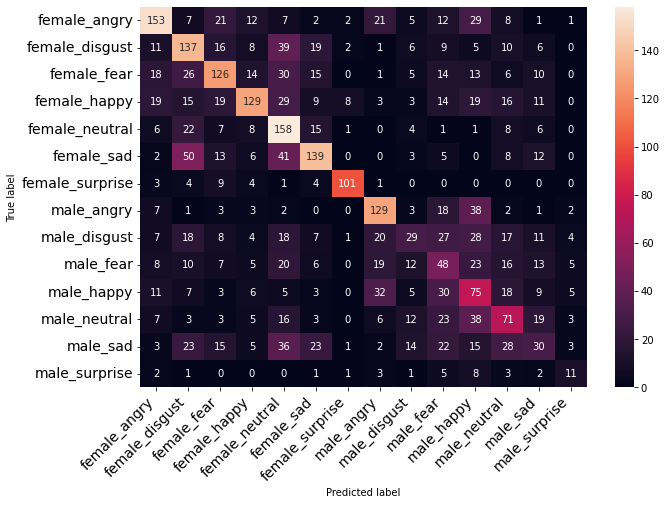

In [ ]:
# Getting the predictions file
finaldf = pd.read_csv("Predictions.csv")
classes = finaldf.actualvalues.unique()
classes.sort()

# Confusion matrix
c = confusion_matrix(finaldf.actualvalues, finaldf.predictedvalues)
print(accuracy_score(finaldf.actualvalues, finaldf.predictedvalues))
print_confusion_matrix(c, class_names = classes)

In [ ]:
# Classification report
classes = finaldf.actualvalues.unique()
classes.sort()
print(classification_report(finaldf.actualvalues, finaldf.predictedvalues, target_names=classes))

                 precision    recall  f1-score   support

   female_angry       0.60      0.54      0.57       281
 female_disgust       0.42      0.51      0.46       269
    female_fear       0.50      0.45      0.48       278
   female_happy       0.62      0.44      0.51       294
 female_neutral       0.39      0.67      0.49       237
     female_sad       0.57      0.50      0.53       279
female_surprise       0.86      0.80      0.83       127
     male_angry       0.54      0.62      0.58       209
   male_disgust       0.28      0.15      0.19       199
      male_fear       0.21      0.25      0.23       192
     male_happy       0.26      0.36      0.30       209
   male_neutral       0.34      0.34      0.34       209
       male_sad       0.23      0.14      0.17       220
  male_surprise       0.32      0.29      0.31        38

       accuracy                           0.44      3041
      macro avg       0.44      0.43      0.43      3041
   weighted avg       0.45   

#### Gender accuracy result

0.8040118382111148


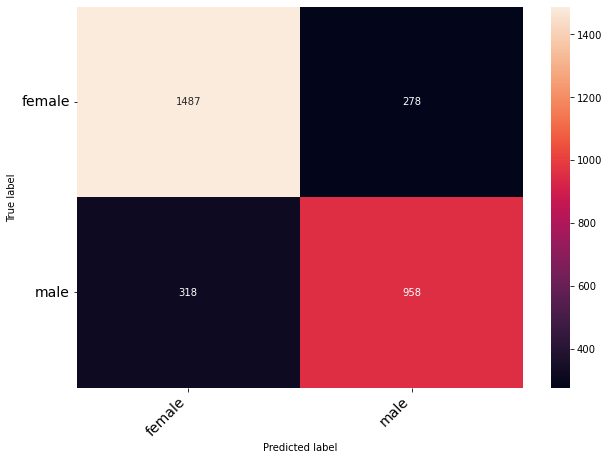

In [ ]:
modidf = finaldf
modidf['actualvalues'] = finaldf.actualvalues.replace({'female_angry':'female'
                                       , 'female_disgust':'female'
                                       , 'female_fear':'female'
                                       , 'female_happy':'female'
                                       , 'female_sad':'female'
                                       , 'female_surprise':'female'
                                       , 'female_neutral':'female'
                                       , 'male_angry':'male'
                                       , 'male_fear':'male'
                                       , 'male_happy':'male'
                                       , 'male_sad':'male'
                                       , 'male_surprise':'male'
                                       , 'male_neutral':'male'
                                       , 'male_disgust':'male'
                                      })

modidf['predictedvalues'] = finaldf.predictedvalues.replace({'female_angry':'female'
                                       , 'female_disgust':'female'
                                       , 'female_fear':'female'
                                       , 'female_happy':'female'
                                       , 'female_sad':'female'
                                       , 'female_surprise':'female'
                                       , 'female_neutral':'female'
                                       , 'male_angry':'male'
                                       , 'male_fear':'male'
                                       , 'male_happy':'male'
                                       , 'male_sad':'male'
                                       , 'male_surprise':'male'
                                       , 'male_neutral':'male'
                                       , 'male_disgust':'male'
                                      })

classes = modidf.actualvalues.unique()
classes.sort()

# Confusion matrix
c = confusion_matrix(modidf.actualvalues, modidf.predictedvalues)
print(accuracy_score(modidf.actualvalues, modidf.predictedvalues))
print_confusion_matrix(c, class_names = classes)

In [ ]:
# Classification report
classes = modidf.actualvalues.unique()
classes.sort()
print(classification_report(modidf.actualvalues, modidf.predictedvalues, target_names=classes))

              precision    recall  f1-score   support

      female       0.82      0.84      0.83      1765
        male       0.78      0.75      0.76      1276

    accuracy                           0.80      3041
   macro avg       0.80      0.80      0.80      3041
weighted avg       0.80      0.80      0.80      3041



### Emotion accuracy

0.49128576126274254


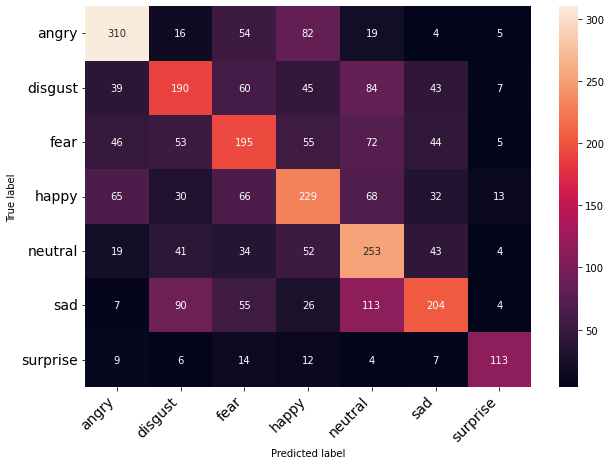

In [ ]:
modidf = pd.read_csv("Predictions.csv")
modidf['actualvalues'] = modidf.actualvalues.replace({'female_angry':'angry'
                                       , 'female_disgust':'disgust'
                                       , 'female_fear':'fear'
                                       , 'female_happy':'happy'
                                       , 'female_sad':'sad'
                                       , 'female_surprise':'surprise'
                                       , 'female_neutral':'neutral'
                                       , 'male_angry':'angry'
                                       , 'male_fear':'fear'
                                       , 'male_happy':'happy'
                                       , 'male_sad':'sad'
                                       , 'male_surprise':'surprise'
                                       , 'male_neutral':'neutral'
                                       , 'male_disgust':'disgust'
                                      })

modidf['predictedvalues'] = modidf.predictedvalues.replace({'female_angry':'angry'
                                       , 'female_disgust':'disgust'
                                       , 'female_fear':'fear'
                                       , 'female_happy':'happy'
                                       , 'female_sad':'sad'
                                       , 'female_surprise':'surprise'
                                       , 'female_neutral':'neutral'
                                       , 'male_angry':'angry'
                                       , 'male_fear':'fear'
                                       , 'male_happy':'happy'
                                       , 'male_sad':'sad'
                                       , 'male_surprise':'surprise'
                                       , 'male_neutral':'neutral'
                                       , 'male_disgust':'disgust'
                                      })

classes = modidf.actualvalues.unique()
classes.sort()

# Confusion matrix
c = confusion_matrix(modidf.actualvalues, modidf.predictedvalues)
print(accuracy_score(modidf.actualvalues, modidf.predictedvalues))
print_confusion_matrix(c, class_names = classes)

In [ ]:
# Classification report
classes = modidf.actualvalues.unique()
classes.sort()
print(classification_report(modidf.actualvalues, modidf.predictedvalues, target_names=classes))

              precision    recall  f1-score   support

       angry       0.63      0.63      0.63       490
     disgust       0.45      0.41      0.43       468
        fear       0.41      0.41      0.41       470
       happy       0.46      0.46      0.46       503
     neutral       0.41      0.57      0.48       446
         sad       0.54      0.41      0.47       499
    surprise       0.75      0.68      0.72       165

    accuracy                           0.49      3041
   macro avg       0.52      0.51      0.51      3041
weighted avg       0.50      0.49      0.49      3041



### AUDIO RECORDING

I've used python itself to run the audio recorder and recorded a track using my sister's voice. However to record the audio, I need a microphone.

In [ ]:
# Importing required libraries
from keras.models import Sequential, Model, model_from_json
import matplotlib.pyplot as plt
import keras
import pickle
import wave  # !pip install wave
import os
import pyaudio
import pandas as pd
import numpy as np
import sys
import warnings
import librosa
import librosa.display
import IPython.display as ipd  # To play sound in the notebook

# ignore warnings
if not sys.warnoptions:
    warnings.simplefilter("ignore")

In [ ]:
CHUNK = 1024
FORMAT = pyaudio.paInt16
CHANNELS = 2
RATE = 44100
RECORD_SECONDS = 4
WAVE_OUTPUT_FILENAME = "C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Testing\\testing.wav"

p = pyaudio.PyAudio()

stream = p.open(format=FORMAT,
                channels=CHANNELS,
                rate=RATE,
                input=True,
                frames_per_buffer=CHUNK) #buffer

print("* recording")

frames = []

for i in range(0, int(RATE / CHUNK * RECORD_SECONDS)):
    data = stream.read(CHUNK)
    frames.append(data) # 2 bytes(16 bits) per channel

print("* done recording")

stream.stop_stream()
stream.close()
p.terminate()

wf = wave.open(WAVE_OUTPUT_FILENAME, 'wb')
wf.setnchannels(CHANNELS)
wf.setsampwidth(p.get_sample_size(FORMAT))
wf.setframerate(RATE)
wf.writeframes(b''.join(frames))
wf.close()

* recording
* done recording


now the audio file below is a pre-recorded audio file which I use to test the model. I've recorded this using the pyaudio code above, and uploaded, It will be visible in my File Directory

In [ ]:
!pip install pyaudio

In [ ]:
data, sampling_rate = librosa.load('C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Testing\\testing.wav')
ipd.Audio('C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Testing\\testing.wav')


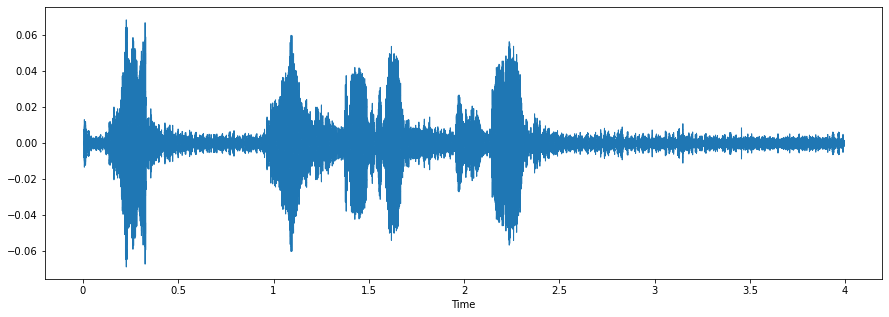

In [ ]:
plt.figure(figsize=(15, 5))
librosa.display.waveshow(data, sr=sampling_rate)

### Data preparation and prediction

I have the audio file ready in my directory, So Now I need to convert it to the correct data format for my model, and I need the serialised models for the weights and the model architecture. Which I aleardy saved within the previous line of codes as the file name - Emotion_Model.h5

In [ ]:
json_file = open('C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\My Model Preparation\\model_json.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)

In [ ]:
loaded_model.load_weights("C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\My saved Model\\Emotion_Model.h5")
print("Loaded model from disk")

Loaded model from disk


Now I need to transform the Audio data

In [ ]:
from tensorflow import keras
from keras import optimizers

In [ ]:
opt = keras.optimizers.RMSprop(lr=0.00001, decay=1e-6)
loaded_model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])

In [ ]:
X, sample_rate = librosa.load('C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Testing\\testing.wav'
                              ,res_type='kaiser_fast'
                              ,duration=2.5
                              ,sr=44100
                              ,offset=0.5
                             )

In [ ]:
sample_rate = np.array(sample_rate)
mfccs = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=13),axis=0)
newdf = pd.DataFrame(data=mfccs).T
newdf

,0,1,2,3,4,5,6,7,8,9,...,206,207,208,209,210,211,212,213,214,215
0,-23.069529,-23.576393,-24.751308,-26.28635,-27.360725,-26.312136,-25.451454,-25.919922,-28.7416,-27.983122,...,-25.875765,-25.730967,-26.781094,-27.23838,-25.665825,-27.406496,-28.194937,-26.010105,-26.342144,-28.350349


And finally I need to run the predictions over it using my saved baseline mode

In [ ]:
# Apply predictions
newdf= np.expand_dims(newdf, axis=2)
newpred = loaded_model.predict(newdf,
                         batch_size=16,
                         verbose=1)

newpred

1/1 [==============================] - 0s 193ms/step


array([[6.7442241e-10, 2.1870925e-09, 7.5420928e-03, 3.5575660e-09,
        3.2227629e-01, 2.0612497e-02, 6.4956915e-01, 1.9073162e-18,
        6.9880408e-12, 3.8274052e-13, 3.2122484e-19, 2.8960559e-17,
        1.3524333e-10, 3.3732438e-13]], dtype=float32)

The prediction is in the form of numbers, we'll need to append the labels to it before we can make sense as to what it has predicted... I already Downloaded the labels file from my previous code

So, No need to run again all the code. I will upload the saved file.

In [ ]:
filename = 'C:\\Users\\lenovo\\OneDrive\Desktop\\Audio Emotion Classification\\My Result\\labels'
infile = open(filename,'rb')
lb = pickle.load(infile)
infile.close()

In [ ]:
final = newpred.argmax(axis=1)
final = final.astype(int).flatten()
final = (lb.inverse_transform((final)))
print(final)

['female_surprise']


MY Final Results:
So my model predicted female surprise as its correct, going back listening to the audio again, I would actually agree with the prediction! Even though I gave specific instructions to my sister to record a Suprise audio, I suppose the emotion exhibited is very similar to suprise.

### Data Augmentation

In [ ]:
import keras
from keras import regularizers
from keras.preprocessing import sequence
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential, Model, model_from_json
from keras.layers import Dense, Embedding, LSTM
from keras.layers import Input, Flatten, Dropout, Activation, BatchNormalization
from keras.layers import Conv1D, MaxPooling1D, AveragePooling1D
from keras.utils import np_utils
from tensorflow.keras.utils import to_categorical
from keras.callbacks import ModelCheckpoint

# sklearn
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# Other
import librosa
import librosa.display
import json
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from matplotlib.pyplot import specgram
import pandas as pd
import seaborn as sns
import glob
import os
from tqdm import tqdm
import pickle
import IPython.display as ipd

Now I will go ahead and test a few methods, then I will implement some using the 1D CNN model so I can decide how much the accuracy contribution came from the data augmentation methods.

In [ ]:
def noise(data):

    #Adding White Noise.
    noise_amp = 0.05*np.random.uniform()*np.amax(data)   # more noise reduce the value to 0.5
    data = data.astype('float64') + noise_amp * np.random.normal(size=data.shape[0])
    return data

In [ ]:
def shift(data):

    #Random Shifting.
    s_range = int(np.random.uniform(low=-5, high = 5)*1000)  #default at 500
    return np.roll(data, s_range)

In [ ]:
def stretch(data,rate=2.0):
    #Streching the Sound. Note that this expands the dataset slightly
    data = librosa.effects.time_stretch(data,rate)
    return data

In [ ]:
def pitch(data, sample_rate):
    """
    Pitch Tuning.
    """
    bins_per_octave = 12
    pitch_pm = 2
    pitch_change =  pitch_pm * 2*(np.random.uniform())
    data = librosa.effects.pitch_shift(data.astype('float64'),
                                      sample_rate, n_steps=pitch_change,
                                      bins_per_octave=bins_per_octave)
    return data

In [ ]:
def dyn_change(data):

    #Random Value Change.

    dyn_change = np.random.uniform(low=-0.5 ,high=7)  # default low = 1.5, high = 3
    return (data * dyn_change)

In [ ]:
def speedNpitch(data):

    #speed and Pitch Tuning.

    length_change = np.random.uniform(low=0.8, high = 1)
    speed_fac = 1.2  / length_change
    tmp = np.interp(np.arange(0,len(data),speed_fac),np.arange(0,len(data)),data)
    minlen = min(data.shape[0], tmp.shape[0])
    data *= 0
    data[0:minlen] = tmp[0:minlen]
    return data

In [ ]:
# the confusion matrix heat map plot

def print_confusion_matrix(confusion_matrix, class_names, figsize = (10,7), fontsize=14):
    df_cm = pd.DataFrame(
        confusion_matrix, index=class_names, columns=class_names,
    )
    fig = plt.figure(figsize=figsize)
    try:
        heatmap = sns.heatmap(df_cm, annot=True, fmt="d")
    except ValueError:
        raise ValueError("Confusion matrix values must be integers.")

    heatmap.yaxis.set_ticklabels(heatmap.yaxis.get_ticklabels(), rotation=0, ha='right', fontsize=fontsize)
    heatmap.xaxis.set_ticklabels(heatmap.xaxis.get_ticklabels(), rotation=45, ha='right', fontsize=fontsize)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

#### Lets start with augmentation method

Methods:

1. static Noise
2. Shift
3. Dynamic Change
4. Speed and Pitch

Before Augmentation, I will take one audio file and run it through all the different types to get a feel for how they work. From there I will then take an Implementation for my model training and hopefully it improves my accuracy for outcome.

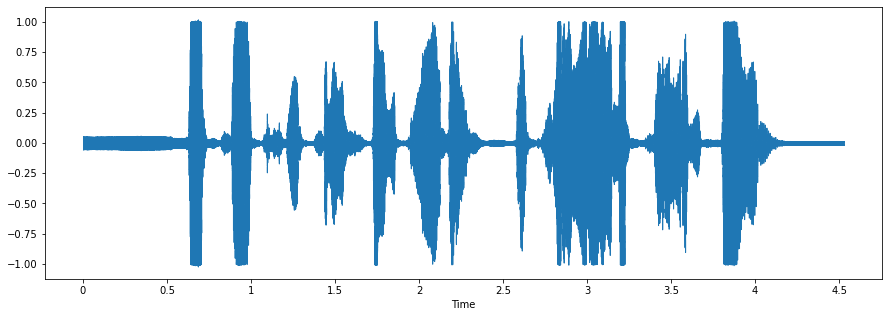

In [ ]:
fname = 'C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\\Data\\savee\\ALL\\JK_f11.wav'
data, sampling_rate = librosa.load(fname)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(data, sr=sampling_rate)

# Paly it again to refresh our memory
ipd.Audio(data, rate=sampling_rate)

###### 1. Noise

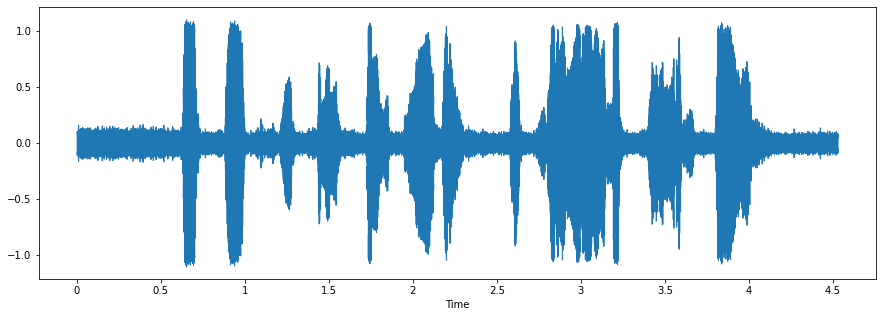

In [ ]:
x = noise(data)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(x, sr=sampling_rate)
ipd.Audio(x, rate=sampling_rate)

Result: That's sounds like a good augmentation, as I can hear the noise background in the audio file.

###### 2. Shift

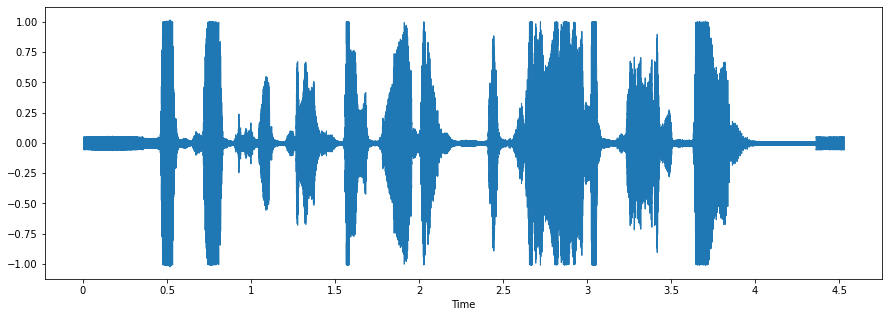

In [ ]:
x = shift(data)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(x, sr=sampling_rate)
ipd.Audio(x, rate=sampling_rate)

Result:  if you compare this to the original plot, I can see the same audio wave pattern, except there's a tiny bit of delay before the speaker starts speaking.

##### 3. Dynamic Change

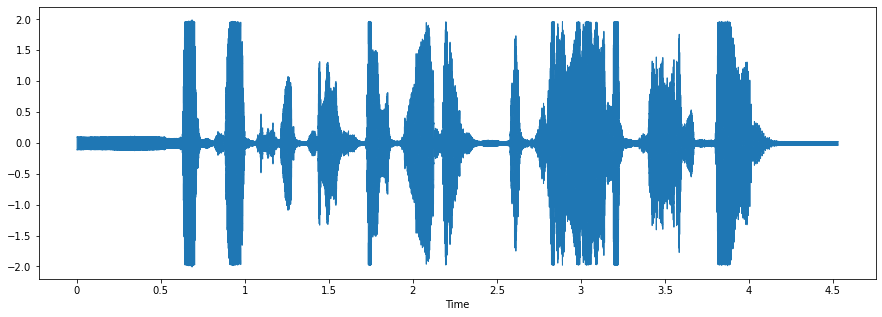

In [ ]:
x = dyn_change(data)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(x, sr=sampling_rate)
ipd.Audio(x, rate=sampling_rate)

It's exactly the same as the original. Yes true, but if I look at the frequency, the wave hits higher frequency notes compared to the original where the min is around -1 and the max is around 1. The min and max of this audio is -6 and 6 respestively.

##### 4. Speed and Pitch

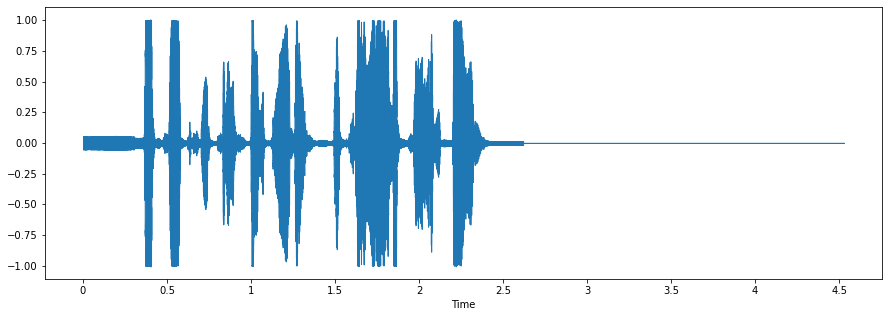

In [ ]:
x = speedNpitch(data)
plt.figure(figsize=(15, 5))
librosa.display.waveshow(x, sr=sampling_rate)
ipd.Audio(x, rate=sampling_rate)

Results: If I listen the audio, It compresses the audio wave but keeping the audio duration the same.

#### Data preparation and processing

I'm going to use just 2 augmentation method which is the noise, and the speed & pitch method. Just for checking samples. So now I will apply it across all my audio data.

And I use the data processing, and I add in the augmentation process in the loop. As I am going to use the noise and speed pitch augmentation method

In [ ]:
ref = pd.read_csv("C:\\Users\\lenovo\\OneDrive\\Desktop\\Audio Emotion Classification\Data\\Data_path.csv")

ref.head()

,labels,source,path
0,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...
1,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...
2,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...
3,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...
4,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...


In [ ]:
df = pd.DataFrame(columns=['feature'])
df_noise = pd.DataFrame(columns=['feature'])
df_speedpitch = pd.DataFrame(columns=['feature'])
cnt = 0

# loop feature extraction over the entire dataset
for i in tqdm(ref.path):

    # first load the audio
    X, sample_rate = librosa.load(i
                                  , res_type='kaiser_fast'
                                  ,duration=2.5
                                  ,sr=44100
                                  ,offset=0.5
                                 )

    # take mfcc and mean as the feature. Could do min and max etc as well.
    mfccs = np.mean(librosa.feature.mfcc(y=X,
                                        sr=np.array(sample_rate),
                                        n_mfcc=13),
                    axis=0)

    df.loc[cnt] = [mfccs]

    # noise
    aug = noise(X)
    aug = np.mean(librosa.feature.mfcc(y=aug,
                                    sr=np.array(sample_rate),
                                    n_mfcc=13),
                  axis=0)
    df_noise.loc[cnt] = [aug]

    # speed pitch
    aug = speedNpitch(X)
    aug = np.mean(librosa.feature.mfcc(y=aug,
                                    sr=np.array(sample_rate),
                                    n_mfcc=13),
                  axis=0)
    df_speedpitch.loc[cnt] = [aug]

    cnt += 1

df.head()

100%|████████████████████████████████████████████████████████████████████████████| 12162/12162 [39:16<00:00,  5.16it/s]


,feature
0,"[-4.641421, -3.860898, -6.21919, -5.9265423, -..."
1,"[-8.690716, -12.522837, -22.928043, -23.243807..."
2,"[-8.814859, -12.819055, -24.178183, -23.84745,..."
3,"[-2.2684252, -4.317077, -12.285237, -13.083024..."
4,"[-13.485307, -16.26042, -25.884357, -27.827044..."


so its definitely longer data will come, almost double the amount of time with the 2 augmentation methods in the loop I done Earlier. Instead of the one data object that I get out, now I will get 2, one for each of the 2 augmentation methods whcih I used.

In [ ]:
df.to_pickle('my4EmotionDatabases-with-augmentation')

In [ ]:
df = pd.read_pickle('my4EmotionDatabases-with-augmentation')
df.head()

,feature
0,"[-4.641421, -3.860898, -6.21919, -5.9265423, -..."
1,"[-8.690716, -12.522837, -22.928043, -23.243807..."
2,"[-8.814859, -12.819055, -24.178183, -23.84745,..."
3,"[-2.2684252, -4.317077, -12.285237, -13.083024..."
4,"[-13.485307, -16.26042, -25.884357, -27.827044..."


In [ ]:
df = pd.concat([ref,pd.DataFrame(df['feature'].values.tolist())],axis=1)
df_noise = pd.concat([ref,pd.DataFrame(df_noise['feature'].values.tolist())],axis=1)
df_speedpitch = pd.concat([ref,pd.DataFrame(df_speedpitch['feature'].values.tolist())],axis=1)
print(df.shape,df_noise.shape,df_speedpitch.shape)

(12162, 219) (12162, 219) (12162, 219)


Results: As the shape of all the 3 datasets are the same as expected. So my new dataset once I get, It will be 3 times the original size, which is handy since Deep Learning needs alot of data for me.

In [ ]:
df = pd.concat([df,df_noise,df_speedpitch],axis=0,sort=False)
df=df.fillna(0)
del df_noise, df_speedpitch

df.head()

,labels,source,path,0,1,2,3,4,5,6,...,206,207,208,209,210,211,212,213,214,215
0,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-4.641421,-3.860898,-6.219190,-5.926542,-5.850419,-4.808960,-2.513003,...,-4.088852,-5.023864,-5.254714,-5.234095,-5.310307,-5.621665,-6.072197,-6.611348,-3.999875,1.390506
1,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-8.690716,-12.522837,-22.928043,-23.243807,-22.926605,-23.432241,-14.830004,...,-22.627258,-22.633406,-22.511597,-24.300154,-24.496809,-22.895985,-23.511503,-24.342152,-16.465857,-8.936035
2,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-8.814859,-12.819055,-24.178183,-23.847450,-15.182783,-10.732485,-8.681472,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-2.268425,-4.317077,-12.285237,-13.083024,-12.041327,-11.819768,-9.414148,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,male_angry,SAVEE,C:\Users\lenovo\OneDrive\Desktop\Audio Emotion...,-13.485307,-16.260420,-25.884357,-27.827044,-27.593534,-26.666508,-18.659023,...,-25.291666,-25.854906,-26.821354,-25.436455,-24.179941,-23.281618,-24.167494,-25.228062,-20.599659,-15.929615


#### Splitting The Dataset

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(df.drop(['path','labels','source'],axis=1)
                                                    , df.labels
                                                    , test_size=0.25
                                                    , shuffle=True
                                                    , random_state=42
                                                   )

# Lets see how the data present itself before normalisation
X_train[150:160]

,0,1,2,3,4,5,6,7,8,9,...,206,207,208,209,210,211,212,213,214,215
3857,-16.223322,-18.668126,-17.116979,-17.477442,-18.048385,-18.389660,-16.610211,-18.291338,-21.502560,-21.450760,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7298,-9.837715,-12.018543,-12.861684,-12.800647,-11.859711,-10.534903,-10.084865,-10.436888,-11.839571,-12.991048,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5874,-19.466393,-17.882383,-17.914045,-16.821308,-16.376284,-16.548979,-17.793001,-15.547514,-15.774050,-16.591759,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
858,-36.373970,-32.657573,-33.170139,-35.108762,-35.179952,-35.659339,-34.993248,-33.561474,-31.562313,-32.684168,...,-24.426830,-24.111259,-24.346450,-22.344033,-21.957838,-22.181846,-22.134707,-22.289333,-19.895448,-15.437782
891,-33.683773,-29.880283,-30.240748,-29.096013,-30.762662,-31.696407,-32.309029,-33.441772,-34.171891,-31.685072,...,-20.329995,-20.197300,-22.178275,-21.099416,-20.182600,-20.427269,-20.889358,-21.818648,-22.207148,-21.145935
1748,-48.436197,-46.226325,-45.919476,-44.982966,-43.589522,-42.966558,-44.060532,-43.744362,-42.293829,-42.695344,...,-44.049226,-43.127064,-43.780956,-43.603756,-42.873037,-42.712745,-44.472985,-44.309099,-45.499278,-49.217806
9995,-6.042688,-7.824288,-7.652111,-7.676592,-9.049874,-8.188551,-8.382911,-9.500729,-7.820495,-7.235802,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5771,-18.790920,-15.083409,-17.024273,-17.871832,-17.670864,-16.764324,-16.967266,-14.339257,-13.911372,-11.508421,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1029,-52.938416,-50.003414,-48.434055,-48.467270,-47.637981,-48.069195,-53.097557,-51.766300,-49.509438,-48.923325,...,-57.102077,-57.102077,-57.102077,-57.102077,-57.102077,-57.102077,-57.102077,-57.102077,-57.102077,-57.102077
10882,-14.439360,-13.470220,-12.429328,-12.580088,-10.772267,-11.617260,-10.138077,-10.891088,-13.813239,-16.311966,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


#### Now, I will Normalize my Data

In [ ]:
mean = np.mean(X_train, axis=0)
std = np.std(X_train, axis=0)

X_train = (X_train - mean)/std
X_test = (X_test - mean)/std

# Check the dataset now
X_train[150:160]

,0,1,2,3,4,5,6,7,8,9,...,206,207,208,209,210,211,212,213,214,215
3857,0.417159,0.183237,0.468767,0.433049,0.380506,0.348022,0.484977,0.345807,0.083781,0.083751,...,0.534147,0.521775,0.521859,0.522509,0.508696,0.509017,0.509580,0.498277,0.494988,0.493732
7298,0.925682,0.726506,0.812465,0.810082,0.878507,0.978894,1.008120,0.974771,0.857003,0.760589,...,0.534147,0.521775,0.521859,0.522509,0.508696,0.509017,0.509580,0.498277,0.494988,0.493732
5874,0.158895,0.247432,0.404389,0.485945,0.515060,0.495860,0.390151,0.565525,0.542170,0.472506,...,0.534147,0.521775,0.521859,0.522509,0.508696,0.509017,0.509580,0.498277,0.494988,0.493732
858,-1.187553,-0.959695,-0.827836,-0.988353,-0.998068,-1.039031,-0.988809,-0.876986,-0.721191,-0.815002,...,-0.744668,-0.750127,-0.761275,-0.653469,-0.657904,-0.668266,-0.662920,-0.691317,-0.569150,-0.327117
891,-0.973317,-0.732792,-0.591231,-0.503617,-0.642609,-0.720739,-0.773613,-0.867401,-0.930007,-0.735067,...,-0.530187,-0.543660,-0.647005,-0.587965,-0.563587,-0.575143,-0.596952,-0.666197,-0.692795,-0.630627
1748,-2.148138,-2.068257,-1.857592,-1.784391,-1.674784,-1.625927,-1.715742,-1.692406,-1.579916,-1.615968,...,-1.771958,-1.753236,-1.785534,-1.772380,-1.769110,-1.757926,-1.846203,-1.866525,-1.938609,-2.123249
9995,1.227902,1.069175,1.233239,1.223173,1.104614,1.167346,1.144567,1.049736,1.178606,1.221050,...,0.534147,0.521775,0.521859,0.522509,0.508696,0.509017,0.509580,0.498277,0.494988,0.493732
5771,0.212687,0.476107,0.476255,0.401254,0.410885,0.478564,0.456351,0.662279,0.691220,0.879210,...,0.534147,0.521775,0.521859,0.522509,0.508696,0.509017,0.509580,0.498277,0.494988,0.493732
1029,-2.506676,-2.376844,-2.060693,-2.065289,-2.000563,-2.035756,-2.440249,-2.334782,-2.157302,-2.114251,...,-2.455312,-2.490437,-2.487598,-2.482804,-2.525086,-2.521628,-2.515180,-2.549293,-2.559203,-2.542467
10882,0.559226,0.607904,0.847386,0.827863,0.966014,0.891962,1.003854,0.938400,0.699072,0.494892,...,0.534147,0.521775,0.521859,0.522509,0.508696,0.509017,0.509580,0.498277,0.494988,0.493732


In [ ]:
X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)

# one hot encode the target
lb = LabelEncoder()
y_train = np_utils.to_categorical(lb.fit_transform(y_train))
y_test = np_utils.to_categorical(lb.fit_transform(y_test))

print(X_train.shape)
print(lb.classes_)

# Pickel the lb object for future use
filename = 'labels1'
outfile = open(filename,'wb')
pickle.dump(lb,outfile)
outfile.close()

(27364, 216)
['female_angry' 'female_disgust' 'female_fear' 'female_happy'
 'female_neutral' 'female_sad' 'female_surprise' 'male_angry'
 'male_disgust' 'male_fear' 'male_happy' 'male_neutral' 'male_sad'
 'male_surprise']


In [ ]:
X_train = np.expand_dims(X_train, axis=2)
X_test = np.expand_dims(X_test, axis=2)
X_train.shape

(27364, 216, 1)

#### Modeling

Now, Iam going to use the same model architecture that I used Earlier Modeling so that I can test my Predictions like for example we can compare apples with apples...and gives the prediction as it matches as it is apple.

In [ ]:
from tensorflow import keras
from keras import optimizers

model = Sequential()
model.add(Conv1D(256, 8, padding='same',input_shape=(X_train.shape[1],1)))  # X_train.shape[1] = No. of Columns
model.add(Activation('relu'))
model.add(Conv1D(256, 8, padding='same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))
model.add(MaxPooling1D(pool_size=(8)))
model.add(Conv1D(128, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(128, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(128, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(128, 8, padding='same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))
model.add(MaxPooling1D(pool_size=(8)))
model.add(Conv1D(64, 8, padding='same'))
model.add(Activation('relu'))
model.add(Conv1D(64, 8, padding='same'))
model.add(Activation('relu'))
model.add(Flatten())
model.add(Dense(14)) # Target class number
model.add(Activation('softmax'))
opt = keras.optimizers.RMSprop(lr=0.00001, decay=1e-6)
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_24 (Conv1D)          (None, 216, 256)          2304      
                                                                 
 activation_27 (Activation)  (None, 216, 256)          0         
                                                                 
 conv1d_25 (Conv1D)          (None, 216, 256)          524544    
                                                                 
 batch_normalization_6 (Batc  (None, 216, 256)         1024      
 hNormalization)                                                 
                                                                 
 activation_28 (Activation)  (None, 216, 256)          0         
                                                                 
 dropout_6 (Dropout)         (None, 216, 256)          0         
                                                      

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer=opt,metrics=['accuracy'])
model_history=model.fit(X_train, y_train, batch_size=16, epochs=150, validation_data=(X_test, y_test),verbose=2)

Epoch 1/150
1711/1711 - 344s - loss: 2.0210 - accuracy: 0.2985 - val_loss: 2.0853 - val_accuracy: 0.2965 - 344s/epoch - 201ms/step
Epoch 2/150
1711/1711 - 344s - loss: 1.9523 - accuracy: 0.3207 - val_loss: 2.0350 - val_accuracy: 0.3113 - 344s/epoch - 201ms/step
Epoch 3/150
1711/1711 - 342s - loss: 1.9000 - accuracy: 0.3404 - val_loss: 1.9776 - val_accuracy: 0.3429 - 342s/epoch - 200ms/step
Epoch 4/150
1711/1711 - 344s - loss: 1.8561 - accuracy: 0.3576 - val_loss: 1.9538 - val_accuracy: 0.3456 - 344s/epoch - 201ms/step
Epoch 5/150
1711/1711 - 338s - loss: 1.8217 - accuracy: 0.3671 - val_loss: 1.9311 - val_accuracy: 0.3617 - 338s/epoch - 198ms/step
Epoch 6/150
1711/1711 - 345s - loss: 1.7933 - accuracy: 0.3752 - val_loss: 1.9001 - val_accuracy: 0.3624 - 345s/epoch - 201ms/step
Epoch 7/150
1711/1711 - 343s - loss: 1.7663 - accuracy: 0.3867 - val_loss: 1.8619 - val_accuracy: 0.3763 - 343s/epoch - 200ms/step
Epoch 8/150
1711/1711 - 348s - loss: 1.7397 - accuracy: 0.3948 - val_loss: 1.8730 -

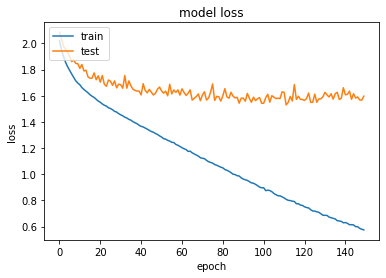

In [ ]:
plt.plot(model_history.history['loss'])
plt.plot(model_history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

#### Model Serialization

In [ ]:
# Save model and weights
model_name = 'Emotion_Model_aug.h5'
save_dir = os.path.join(os.getcwd(), 'saved_models')

if not os.path.isdir(save_dir):
    os.makedirs(save_dir)
model_path = os.path.join(save_dir, model_name)
model.save(model_path)
print('Save model and weights at %s ' % model_path)

# Save the model to disk
model_json = model.to_json()
with open("model_json_aug.json", "w") as json_file:
    json_file.write(model_json)

Save model and weights at C:\Users\lenovo\saved_models\Emotion_Model_aug.h5 


##### Model Validation

In [ ]:
from tensorflow import keras
from keras import optimizers


# loading json and model architecture
json_file = open('model_json_aug.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)

# load weights into new model
loaded_model.load_weights("saved_models/Emotion_Model_aug.h5")
print("Loaded model from disk")

# Keras optimiser
opt = keras.optimizers.RMSprop(lr=0.00001, decay=1e-6)
loaded_model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
score = loaded_model.evaluate(X_test, y_test, verbose=0)
print("%s: %.2f%%" % (loaded_model.metrics_names[1], score[1]*100))

Loaded model from disk
accuracy: 48.19%


Results:
Now This time I got 48.19% it is higher as it is improved compared to previous.

In [ ]:
preds = loaded_model.predict(X_test,
                         batch_size=16,
                         verbose=1)

preds=preds.argmax(axis=1)
preds

571/571 [==============================] - 51s 88ms/step


array([2, 1, 1, ..., 3, 3, 0], dtype=int64)

Then Now I need to append the labels to it before I run the accuracy measure.

In [ ]:
# predictions
preds = preds.astype(int).flatten()
preds = (lb.inverse_transform((preds)))
preds = pd.DataFrame({'predictedvalues': preds})

# Actual labels
actual=y_test.argmax(axis=1)
actual = actual.astype(int).flatten()
actual = (lb.inverse_transform((actual)))
actual = pd.DataFrame({'actualvalues': actual})

# Lets combined both of them into a single dataframe
finaldf = actual.join(preds)
finaldf[170:180]

,actualvalues,predictedvalues
170,female_surprise,female_surprise
171,female_fear,female_fear
172,female_neutral,female_neutral
173,female_neutral,female_disgust
174,male_surprise,male_angry
175,male_disgust,male_disgust
176,female_fear,female_fear
177,female_disgust,female_disgust
178,male_neutral,male_sad
179,male_fear,female_happy


Now, I am going to save my new predictions file as predictions1.csv

In [ ]:
# Write out the predictions to disk
finaldf.to_csv('Predictions1.csv', index=False)
finaldf.groupby('predictedvalues').count()

,actualvalues
predictedvalues,
female_angry,988
female_disgust,1069
female_fear,1014
female_happy,1128
female_neutral,793
female_sad,1068
female_surprise,413
male_angry,445
male_disgust,432


#### Emotion by gender accuracy

0.4819118614338961


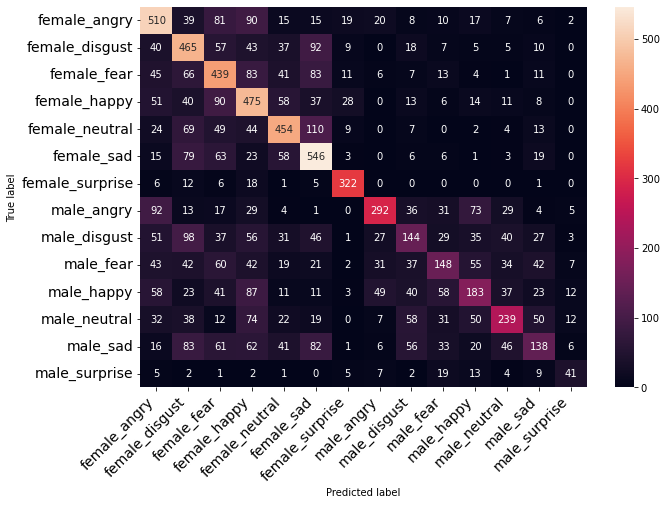

In [ ]:
# Get the predictions file
finaldf = pd.read_csv("Predictions1.csv")
classes = finaldf.actualvalues.unique()
classes.sort()

# Confusion matrix
c = confusion_matrix(finaldf.actualvalues, finaldf.predictedvalues)
print(accuracy_score(finaldf.actualvalues, finaldf.predictedvalues))
print_confusion_matrix(c, class_names = classes)

In [ ]:
# Classification report
classes = finaldf.actualvalues.unique()
classes.sort()
print(classification_report(finaldf.actualvalues, finaldf.predictedvalues, target_names=classes))

                 precision    recall  f1-score   support

   female_angry       0.52      0.61      0.56       839
 female_disgust       0.43      0.59      0.50       788
    female_fear       0.43      0.54      0.48       810
   female_happy       0.42      0.57      0.48       831
 female_neutral       0.57      0.58      0.58       785
     female_sad       0.51      0.66      0.58       822
female_surprise       0.78      0.87      0.82       371
     male_angry       0.66      0.47      0.55       626
   male_disgust       0.33      0.23      0.27       625
      male_fear       0.38      0.25      0.30       583
     male_happy       0.39      0.29      0.33       636
   male_neutral       0.52      0.37      0.43       644
       male_sad       0.38      0.21      0.27       651
  male_surprise       0.47      0.37      0.41       111

       accuracy                           0.48      9122
      macro avg       0.49      0.47      0.47      9122
   weighted avg       0.48   

Results:
The accuracy for the gender by emotions in Previous is 44%, and Now I got 48%, which is great.

#### Gender accuracy result

0.8060732295549222


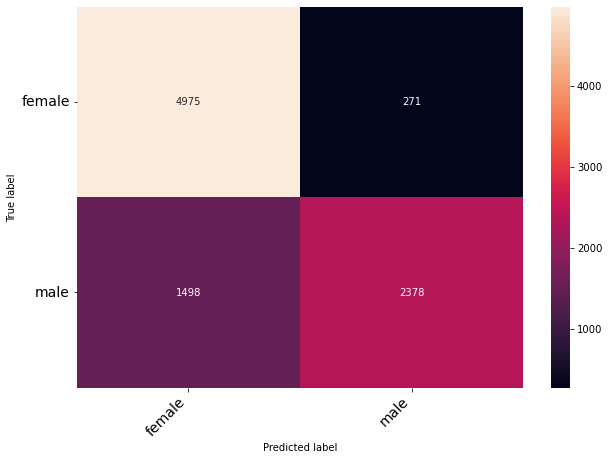

In [ ]:
modidf = finaldf
modidf['actualvalues'] = finaldf.actualvalues.replace({'female_angry':'female'
                                       , 'female_disgust':'female'
                                       , 'female_fear':'female'
                                       , 'female_happy':'female'
                                       , 'female_sad':'female'
                                       , 'female_surprise':'female'
                                       , 'female_neutral':'female'
                                       , 'male_angry':'male'
                                       , 'male_fear':'male'
                                       , 'male_happy':'male'
                                       , 'male_sad':'male'
                                       , 'male_surprise':'male'
                                       , 'male_neutral':'male'
                                       , 'male_disgust':'male'
                                      })

modidf['predictedvalues'] = finaldf.predictedvalues.replace({'female_angry':'female'
                                       , 'female_disgust':'female'
                                       , 'female_fear':'female'
                                       , 'female_happy':'female'
                                       , 'female_sad':'female'
                                       , 'female_surprise':'female'
                                       , 'female_neutral':'female'
                                       , 'male_angry':'male'
                                       , 'male_fear':'male'
                                       , 'male_happy':'male'
                                       , 'male_sad':'male'
                                       , 'male_surprise':'male'
                                       , 'male_neutral':'male'
                                       , 'male_disgust':'male'
                                      })

classes = modidf.actualvalues.unique()
classes.sort()

# Confusion matrix
c = confusion_matrix(modidf.actualvalues, modidf.predictedvalues)
print(accuracy_score(modidf.actualvalues, modidf.predictedvalues))
print_confusion_matrix(c, class_names = classes)

In [ ]:
# Classification report
classes = modidf.actualvalues.unique()
classes.sort()
print(classification_report(modidf.actualvalues, modidf.predictedvalues, target_names=classes))

              precision    recall  f1-score   support

      female       0.77      0.95      0.85      5246
        male       0.90      0.61      0.73      3876

    accuracy                           0.81      9122
   macro avg       0.83      0.78      0.79      9122
weighted avg       0.82      0.81      0.80      9122



Results:
The accuracy for the gender Accuracy in Previous is 80%, and Now I got 81%, which is not bad.

#### Emotion accuracy

0.5404516553387415


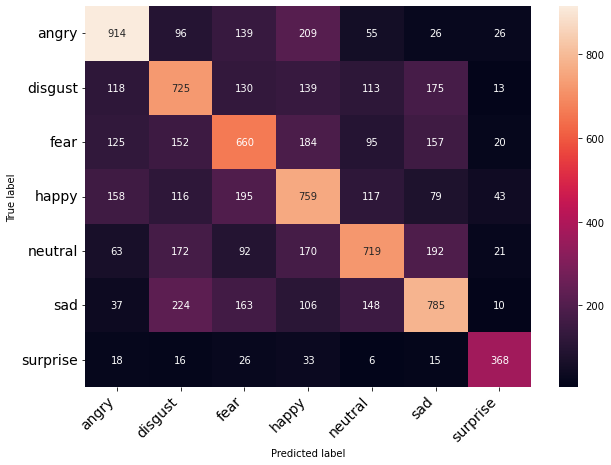

In [ ]:
modidf = pd.read_csv("Predictions1.csv")
modidf['actualvalues'] = modidf.actualvalues.replace({'female_angry':'angry'
                                       , 'female_disgust':'disgust'
                                       , 'female_fear':'fear'
                                       , 'female_happy':'happy'
                                       , 'female_sad':'sad'
                                       , 'female_surprise':'surprise'
                                       , 'female_neutral':'neutral'
                                       , 'male_angry':'angry'
                                       , 'male_fear':'fear'
                                       , 'male_happy':'happy'
                                       , 'male_sad':'sad'
                                       , 'male_surprise':'surprise'
                                       , 'male_neutral':'neutral'
                                       , 'male_disgust':'disgust'
                                      })

modidf['predictedvalues'] = modidf.predictedvalues.replace({'female_angry':'angry'
                                       , 'female_disgust':'disgust'
                                       , 'female_fear':'fear'
                                       , 'female_happy':'happy'
                                       , 'female_sad':'sad'
                                       , 'female_surprise':'surprise'
                                       , 'female_neutral':'neutral'
                                       , 'male_angry':'angry'
                                       , 'male_fear':'fear'
                                       , 'male_happy':'happy'
                                       , 'male_sad':'sad'
                                       , 'male_surprise':'surprise'
                                       , 'male_neutral':'neutral'
                                       , 'male_disgust':'disgust'
                                      })

classes = modidf.actualvalues.unique()
classes.sort()

# Confusion matrix
c = confusion_matrix(modidf.actualvalues, modidf.predictedvalues)
print(accuracy_score(modidf.actualvalues, modidf.predictedvalues))
print_confusion_matrix(c, class_names = classes)

In [ ]:
# Classification report
classes = modidf.actualvalues.unique()
classes.sort()
print(classification_report(modidf.actualvalues, modidf.predictedvalues, target_names=classes))

              precision    recall  f1-score   support

       angry       0.64      0.62      0.63      1465
     disgust       0.48      0.51      0.50      1413
        fear       0.47      0.47      0.47      1393
       happy       0.47      0.52      0.49      1467
     neutral       0.57      0.50      0.54      1429
         sad       0.55      0.53      0.54      1473
    surprise       0.73      0.76      0.75       482

    accuracy                           0.54      9122
   macro avg       0.56      0.56      0.56      9122
weighted avg       0.54      0.54      0.54      9122



In [ ]:
Final Results:

The accuracy for the emotion accuracy in Previous is 49%, and Now I got 54%, which is good.